In [45]:
import xarray as xr
import rioxarray
import pandas as pd
import geopandas as gpd
import numpy as np
from glob import glob
import h5py
import cartopy
import pyart
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)
warnings.filterwarnings('ignore', category=RuntimeWarning)
# pyplot needed to plot the dataset, but animation only needed much further down.
from matplotlib import animation
%matplotlib inline

# This is needed to display graphics calculated outside of jupyter notebook
from IPython.display import HTML, display

import sys
sys.path.append('~/PlotGallery')
from matplotlibconfig import basic
basic()

In [2]:
dict_hurricanes= {
    'Barry': {'datetime': [], 'points':[]},
    'Beta': {'datetime': [], 'points':[]},
    'Cindy': {'datetime': [], 'points':[]},
    'Delta': {'datetime': [], 'points':[]},
    'Hanna': {'datetime': [], 'points':[]},
    'Harvey': {'datetime': [], 'points':[]},
    'Imelda': {'datetime': [], 'points':[]},
    'Laura': {'datetime': [], 'points':[]},
    'Florence': {'datetime': [], 'points': []}
}

In [3]:
for event in dict_hurricanes.keys():
    fname= glob('tracks/%s/*_pts.shp'%(event))[0]
    pnts= gpd.read_file(fname)
    pnts.DTG= pd.to_datetime(pnts.DTG, format='%Y%m%d%H')
    dict_hurricanes[event]['datetime']= sorted(pnts.DTG.tolist())
    order= np.argsort(pnts.DTG.values)
    dict_hurricanes[event]['points']= list(zip(pnts.LON.values[order], pnts.LAT.values[order]))

In [10]:
AOI= gpd.read_file('area/great_extent.geojson').to_crs('EPSG:4326')
AOI['REGION']= 1
AOI= AOI.dissolve(by='REGION')

In [13]:
lccProjParams = { 'central_latitude'   : 50.0, # same as lat_0 in proj4 string 
                  'central_longitude'  : -96.0, # same as lon_0
                  'standard_parallels' : (33.0, 45.0) # same as (lat_1, lat_2)
}

proj = cartopy.crs.LambertConformal(**lccProjParams)

# Soil moisture climatology

In [218]:
sm_clima=xr.open_rasterio('SM_climatology.tiff')

/home/ZhiLi/.conda/envs/xesmf_env/lib/python3.7/site-packages/ipykernel_launcher.py:14: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  


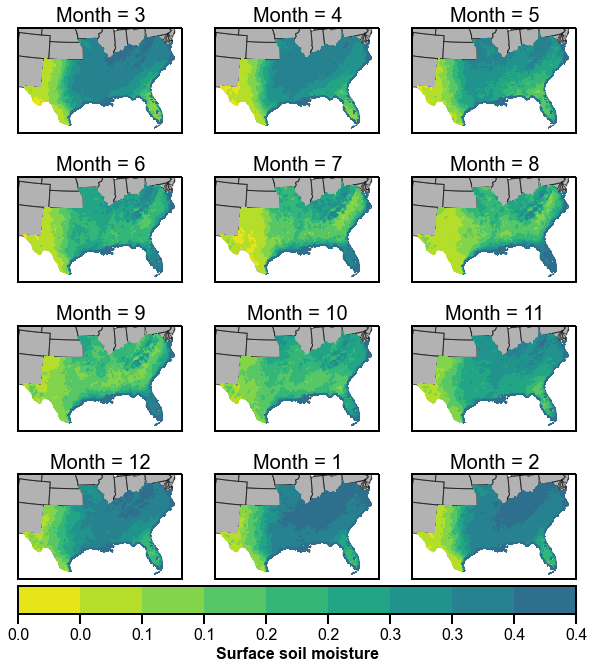

In [247]:
fig,axes= plt.subplots(4,3,subplot_kw={'projection': proj}, figsize=(10,13), gridspec_kw={'hspace':0.01})
for i, mon in enumerate([3,4,5,6,7,8,9,10,11,12,1,2]):
#     if mon<3:
    ax= axes[i//3, i%3]
    _sm= sm_clima.sel(band=mon)
    map=ax.contourf(_sm.x.values, _sm.y.values, _sm.values/100., cmap='viridis_r',
               transform=cartopy.crs.PlateCarree(),
                    vmin=0, vmax=0.4)
    ax.set_title('Month = %d'%mon)
    ax.add_feature(cartopy.feature.STATES, alpha=0.6, facecolor='grey', zorder=0)
cb= fig.colorbar(ax=axes, orientation='horizontal', mappable=map,pad=0.01)
cb.set_ticklabels(['%.1f'%num for num in np.linspace(0,0.4,10)])
cb.set_label('Surface soil moisture')
plt.tight_layout()
plt.show();

In [235]:
def get_IMERG(start, end):
    global AOI
    dr= pd.date_range(start,end, freq='6H')
    fnames= ['/media/scratch/ZhiLi/Final/%s.HDF5'%dt.strftime('%Y%m%d%H%M%S') for dt in dr]
    ds= []
    for i,fname in enumerate(fnames):
        with h5py.File(fname, 'r') as f:
            precip= f['Grid/precipitationCal'][:].squeeze().transpose(1,0)
#             precip= np.flip(precip, axis=0)
            lon= f['Grid/lon'][:].squeeze()
            lat= f['Grid/lat'][:].squeeze()
            da= xr.Dataset(
                    {'rain':(["time", 'y', 'x'], precip.reshape(1, 1800, 3600))},
                    {'time': [dr[i]], 'y': lat, 'x': lon})
        clipped= da.rain.rio.set_crs('EPSG:4326').rio.clip([AOI.geometry[0]], drop=True)
        ds.append(clipped)
            
    ds= xr.concat(ds, dim='time')
    return ds

In [200]:
ds= get_IMERG(dict_hurricanes['Harvey']['datetime'][0], dict_hurricanes['Harvey']['datetime'][-1])

In [206]:
ds= ds.where(ds!=0)

# Get a handle on the figure and the axes
fig, ax = plt.subplots(figsize=(12,8), subplot_kw={'projection':proj})

# Plot the initial frame. 
cax = ax.pcolormesh(ds.x.values,ds.y.values, ds[0,:,:], cmap=pyart.graph.cm.NWSRef, transform=cartopy.crs.PlateCarree(),
                    vmin=5, vmax=np.nanmax(ds)*0.8)
ax.add_feature(cartopy.feature.STATES, alpha=0.6)
fig.colorbar(mappable=cax, pad=0.01)
AOI.plot(ax=ax, color='None', ec='r',transform=cartopy.crs.PlateCarree())
# ax.plot()

# Next we need to create a function that updates the values for the colormesh, as well as the title.
def animate(frame):
    time= ds.time[frame]

        
#     cax.set_array(ds[frame,:,:].values.reshape(-1))
    cax = ax.pcolormesh(ds.x.values,ds.y.values, ds[frame,:,:],
                        cmap=pyart.graph.cm.NWSRef,
                        transform=cartopy.crs.PlateCarree(),
                        vmin=5, vmax=np.nanmax(ds))
#     if time in dict_hurricanes['Harvey']['datetime']:
#         ax.plot(dict_hurricanes['Harvey']['datetime'])
#     ax.add_feature(cartopy.feature.STATES, alpha=0.6)
#     AOI.plot(ax=ax, color='None', ec='r',transform=cartopy.crs.PlateCarree())
    ax.set_title("Time = " + str(ds.coords['time'].values[frame])[:13])

# Finally, we use the animation module to create the animation.
ani = animation.FuncAnimation(
    fig,             # figure
    animate,         # name of the function above
    frames=len(ds),       # Could also be iterable or list
    interval=200     # ms between frames
)
plt.close();

In [207]:
HTML(ani.to_jshtml())

In [326]:
EVENT= 'Florence'
fnames= ['/media/scratch/ZhiLi/soil_moisture/CYGNSS/ucar_cu_cygnss_sm_v1_2018_%03d.nc'%dt.dayofyear for dt in dict_hurricanes[EVENT]['datetime']]
cygnss= xr.open_mfdataset(fnames)
cygnss['lat']= cygnss.latitude.values[0,:,0]
cygnss['lon']= cygnss.longitude.values[0,0,:]
# mask_i= 
cygnss= cygnss.rename({'lon': 'x', 'lat':'y'}).SM_subdaily.rio.set_crs('EPSG:4326').rio.clip([AOI.geometry.iloc[0]])
# ilons= (cygnss.lon<= -74) & (cygnss.lon>= -107)

cygnss_arr= np.zeros((cygnss.shape[0]*4,cygnss.shape[-2],cygnss.shape[-1]))
for i in range(cygnss.shape[0]*4):
    cygnss_arr[i,:,:]= cygnss[i//4,i%4,:,:]

In [33]:
# Get a handle on the figure and the axes
fig, ax = plt.subplots(figsize=(12,8), subplot_kw={'projection':proj})

# Plot the initial frame. 
cax = ax.pcolormesh(cygnss.x.values,cygnss.y.values, cygnss_arr[0,:,:], cmap='viridis_r',
                  transform=cartopy.crs.PlateCarree(),
                    vmin=0, vmax=1)
aax= ax.plot(*list(dict_hurricanes[EVENT]['points'][0]))
ax.add_feature(cartopy.feature.STATES, alpha=0.6)
fig.colorbar(mappable=cax, pad=0.01)
AOI.plot(ax=ax, color='None', ec='r',transform=cartopy.crs.PlateCarree())
# ax.plot()
time_range= pd.date_range(pd.to_datetime(cygnss.time[0].values).strftime('%Y%m%d000000'),
                          (pd.to_datetime(cygnss.time[-1].values)+pd.Timedelta(days=1)).strftime('%Y%m%d000000'),
                          freq='6H', closed='left')
ax.set_extent([-102, -87, 24, 36])
# Next we need to create a function that updates the values for the colormesh, as well as the title.
def animate(frame):
    time= time_range[frame]
    cax = ax.pcolormesh(cygnss.x.values,cygnss.y.values, cygnss_arr[frame,:,:],
                        cmap='viridis_r',
                        transform=cartopy.crs.PlateCarree(),
                        vmin=0, vmax=1)    
    if time in dict_hurricanes[EVENT]['datetime']:
        section= pd.to_datetime(dict_hurricanes[EVENT]['datetime']).get_loc(time)
        locs= np.stack(dict_hurricanes[EVENT]['points'])[:section+1,:]
        aax= ax.plot(locs[:,0], locs[:,1], 'r-', linewidth=2, marker='o', transform=cartopy.crs.PlateCarree())


    ax.set_title("Time = " + str(time.strftime('%Y-%m-%dT%H')))
    ax.set_extent([-107, -74, 24, 41])

# Finally, we use the animation module to create the animation.
ani = animation.FuncAnimation(
    fig,             # figure
    animate,         # name of the function above
    frames=len(cygnss_arr),       # Could also be iterable or list
    interval=200     # ms between frames
)
plt.close();

/home/ZhiLi/.conda/envs/xesmf_env/lib/python3.7/site-packages/geopandas/plotting.py:433: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  plt.draw()


In [34]:
HTML(ani.to_jshtml())

In [329]:
# SMAP
import datetime as dte
def read_SML3P_AM(filepath):
    ''' This function extracts lat, lon and soil moisture from SMAP L3 P HDF5 file.
    
    Parameters
    ----------
    filepath : str
        File path of a SMAP L3 HDF5 file
    Returns
    -------
    soil_moisture_am: numpy.array
    '''    
    with h5py.File(filepath, 'r') as f:
        # Extract data info
        group_id_am = 'Soil_Moisture_Retrieval_Data_AM'
        var_id_am = 'soil_moisture'
        flag_id_am = 'retrieval_qual_flag'
        soil_moisture_am = f[group_id_am][var_id_am][:,:]
        flag_am = f[group_id_am][flag_id_am][:,:]
        soil_moisture_am[soil_moisture_am==-9999.0]=np.nan;
#         soil_moisture_am[(flag_am>>0)&1==1]=np.nan
        filename = os.path.basename(filepath)
        yyyymmdd= filename.split('_')[5]
        yyyy = int(yyyymmdd[0:4]);        mm = int(yyyymmdd[4:6]);        dd = int(yyyymmdd[6:8])
        date=dte.datetime(yyyy,mm,dd,6)
        lon=f[group_id_am]['longitude'][:]
        lat= f[group_id_am]['latitude'][:]
    return soil_moisture_am,date,lon,lat

def read_SML3P_PM(filepath):
    ''' This function extracts lat, lon and soil moisture from SMAP L3 P HDF5 file.
    
    Parameters
    ----------
    filepath : str
        File path of a SMAP L3 HDF5 file
    Returns
    -------
    soil_moisture_am: numpy.array
    '''    
    with h5py.File(filepath, 'r') as f:
        # Extract data info
        group_id_am = 'Soil_Moisture_Retrieval_Data_PM'
        var_id_am = 'soil_moisture_pm'
        flag_id_am = 'retrieval_qual_flag_pm'
        soil_moisture_am = f[group_id_am][var_id_am][:,:]
        flag_am = f[group_id_am][flag_id_am][:,:]
        soil_moisture_am[soil_moisture_am==-9999.0]=np.nan;
#         soil_moisture_am[(flag_am>>0)&1==1]=np.nan
        filename = os.path.basename(filepath)
        yyyymmdd= filename.split('_')[5]
        yyyy = int(yyyymmdd[0:4]);        mm = int(yyyymmdd[4:6]);        dd = int(yyyymmdd[6:8])
        date=dte.datetime(yyyy,mm,dd,18)
        lon=f[group_id_am]['longitude_pm'][:]
        lat= f[group_id_am]['latitude_pm'][:]
    return soil_moisture_am,date,lon,lat

In [330]:
from functools import partial
import multiprocessing

def find_nearest_single(field, src_lons, src_lats, args): 
    tar_lon,tar_lat=args
    value= field[np.unravel_index(np.argmin((src_lons-tar_lon)**2 + (src_lats-tar_lat)**2), src_lons.shape)] \
              if (((src_lons-tar_lon)**2+ (src_lats-tar_lat)**2)**0.5).min()<0.3 else np.nan
#     values= np.array(values)
    
    return value

def find_avg_single(field, src_lons, src_lats, args): 
    tar_lon,tar_lat=args
    mask= ((src_lons - tar_lon)**2 + (src_lats - tar_lat)**2)**0.5 < (0.3734436/2)
    value= field[mask].mean()
    
    return value

def find_nearest(field, src_lons, src_lats, tar_lons, tar_lats):
    if len(src_lons.shape)!=2 or len(src_lats.shape)!=2:
        raise ValueError('input source lons and lats should be 2-dimensional.')
    
    func= partial(find_avg_single, field, src_lons, src_lats)
    args= [(_lon,_lat) for _lat in tar_lats for _lon in tar_lons]
    with multiprocessing.Pool(30) as pool:
        results= pool.map(func, args)
        
    return np.array(results).reshape(tar_lats.shape[0], tar_lons.shape[0])

In [331]:
sms= []
times= []
time_range_SMAP= pd.date_range(pd.to_datetime(dict_hurricanes[EVENT]['datetime'][0]),
                              pd.to_datetime(dict_hurricanes[EVENT]['datetime'][-1]),
                               freq='D')
for datetime in time_range_SMAP:
    fname= glob('/media/scratch/ZhiLi/SMAP/SMAP_L3_SM_P_E_%s*'%datetime.strftime('%Y%m%d'))[0]
    sm,sm_time,lon,lat=read_SML3P_AM(fname)
    
    if ((lon>cygnss.x.values.min()) & (lon<cygnss.x.values.max()) & (lat>cygnss.y.values.min()) &\
        (lat<cygnss.y.values.max())).any():
        sm_values= find_nearest(sm, lon, lat, cygnss.x.values, cygnss.y.values)
        sms.append(sm_values)
        times.append(sm_time)
    sm,time,lon,lat=read_SML3P_PM(fname)
    if ((lon>cygnss.x.values.min()) & (lon<cygnss.x.values.max()) & (lat>cygnss.y.values.min()) &
        (lat<cygnss.y.values.max())).any():    
        
        sm_values= find_nearest(sm, lon, lat, cygnss.x.values, cygnss.y.values)
        sms.append(sm_values)
        times.append(time)    

In [55]:
# Get a handle on the figure and the axes
fig, ax = plt.subplots(figsize=(12,8), subplot_kw={'projection':proj})

# Plot the initial frame. 
cax = ax.pcolormesh(cygnss.x.values, cygnss.y.values, sms[0], cmap='viridis_r',
                  transform=cartopy.crs.PlateCarree(),
                    vmin=0, vmax=1)
aax= ax.plot(*list(dict_hurricanes[EVENT]['points'][0]))
ax.add_feature(cartopy.feature.STATES, alpha=0.6)
fig.colorbar(mappable=cax, pad=0.01)
AOI.plot(ax=ax, color='None', ec='r',transform=cartopy.crs.PlateCarree())
# ax.plot()
time_range= pd.date_range(pd.to_datetime(cygnss.time[0].values).strftime('%Y%m%d000000'),
                          (pd.to_datetime(cygnss.time[-1].values)+pd.Timedelta(days=1)).strftime('%Y%m%d000000'),
                          freq='6H', closed='left')
ax.set_extent([-102, -87, 24, 36])
# Next we need to create a function that updates the values for the colormesh, as well as the title.
def animate(frame):
    time= times[frame]
    cax = ax.pcolormesh(cygnss.x.values, cygnss.y.values, sms[frame],
                        cmap='viridis_r',
                        transform=cartopy.crs.PlateCarree(),
                        vmin=0, vmax=1)    
    if time in dict_hurricanes[EVENT]['datetime']:
        section= pd.to_datetime(dict_hurricanes[EVENT]['datetime']).get_loc(time)
        locs= np.stack(dict_hurricanes[EVENT]['points'])[:section+1,:]
        aax= ax.plot(locs[:,0], locs[:,1], 'r-', linewidth=2, marker='o', transform=cartopy.crs.PlateCarree())


    ax.set_title("Time = " + str(time.strftime('%Y-%m-%dT%H')))
    ax.set_extent([-107, -74, 24, 41])

# Finally, we use the animation module to create the animation.
ani = animation.FuncAnimation(
    fig,             # figure
    animate,         # name of the function above
    frames=len(times),       # Could also be iterable or list
    interval=200     # ms between frames
)
plt.close();

/home/ZhiLi/.conda/envs/xesmf_env/lib/python3.7/site-packages/geopandas/plotting.py:433: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  plt.draw()


In [57]:
HTML(ani.to_jshtml())

In [58]:
import netCDF4 as nc4

In [59]:
from netCDF4 import num2date, date2num

In [333]:
import time
# time_range= pd.date_range('20170816000000',
#                           '20170903000000',freq='6H', closed='left')
with nc4.Dataset('data/data_Florence.nc', 'w', format='NETCDF4') as f:
    f.history = "Created " + time.ctime(time.time())
    f.source = "netCDF4 python API"    
    f.description= 'Matched soil moisture products for CYGNSS and SMAP, by Allen'
    f.createDimension('time_cygnss', len(time_range))
    f.createDimension('time_smap', len(times))
    f.createDimension('lon', len(cygnss.x.values))
    f.createDimension('lat', len(cygnss.y.values))
    
    sm_cygnss=f.createVariable('sm_cygnss', 'f8', ('time_cygnss', 'lat', 'lon'), fill_value=-9999, zlib=True)
    sm_smap= f.createVariable('sm_smap', 'f8', ('time_smap', 'lat', 'lon'), fill_value=-9999, zlib=True)    
    lon= f.createVariable('lon', 'f4', 'lon', fill_value=-9999, zlib=True)
    lat= f.createVariable('lat', 'f4', 'lat', fill_value=-9999, zlib=True)    
    lon[:]= cygnss.x.values
    lat[:]= cygnss.y.values
    time_cygnss= f.createVariable('time_cygnss', 'f4', 'time_cygnss', fill_value=-9999, zlib=True)
    time_smap= f.createVariable('time_smap', 'f4', 'time_smap', fill_value=-9999, zlib=True)    
    time_cygnss[:]= [date2num(dt, 'hours since 2016-01-01 00:00:00', 'standard') for dt in time_range]
    time_cygnss.units= 'hours since 2016-01-01 00:00:00'
    time_cygnss.calendar='standard'
    time_smap[:]= [date2num(dt, 'hours since 2016-01-01 00:00:00', 'standard') for dt in times]
    time_smap.units= 'hours since 2016-01-01 00:00:00'
    time_smap.calendar='standard'    
    sms= np.stack(sms)
    sms[np.isnan(sms)]= -9999
    cygnss_arr[np.isnan(cygnss_arr)]=-9999
    sm_smap[:]= sms
    sm_cygnss[:]= cygnss_arr
    sm_smap.units= 'm3/m3'
    sm_cygnss.units= 'm3/m3'

<class 'netCDF4._netCDF4.Dimension'>: name = 'time_cygnss', size = 76

<class 'netCDF4._netCDF4.Dimension'>: name = 'time_smap', size = 38

<class 'netCDF4._netCDF4.Dimension'>: name = 'lon', size = 83

<class 'netCDF4._netCDF4.Dimension'>: name = 'lat', size = 46

In [334]:
ds= xr.open_dataset('data/data_Florence.nc').load()

In [386]:
ds.close()

In [261]:
# anomally
sm_aug= sm_clima.sel(band=8)
xx_sm,yy_sm = np.meshgrid(sm_aug.x.values, sm_aug.y.values)
sm_aug_regrid= find_nearest(sm_aug.values, xx_sm, yy_sm, ds.lon.values, ds.lat.values)
ds['sm_cygnss_ano']= ds.sm_cygnss - sm_aug_regrid
ds['sm_smap_ano']= ds.sm_smap - sm_aug_regrid

In [90]:
intersected_time= pd.to_datetime(ds.time_smap.values).intersection(pd.to_datetime(ds.time_cygnss.values))

In [91]:
intersected_ds= ds.sel(time_cygnss=intersected_time)

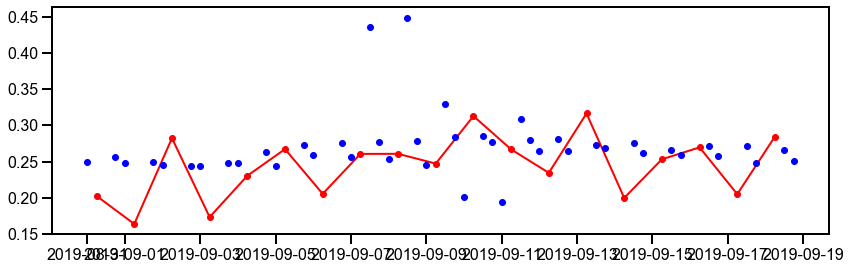

In [119]:
fig=plt.figure(figsize=(12,4))
ax= fig.add_subplot(111)
ax.plot(ds.mean(dim=['lon','lat']).time_smap.values, ds.mean(dim=['lon','lat']).sm_smap.values, color='r', marker='o')
ax.plot(ds.mean(dim=['lon','lat']).time_cygnss.values, ds.mean(dim=['lon','lat']).sm_cygnss.values,
        color='b', marker='o', linestyle='None')
# ax.set_xticks(ds.mean(dim=['lon','lat']).time_smap.values)
# ax.set_xticklabels(ds.mean(dim=['lon','lat']).time_smap.values, rotation=15)

In [94]:
intersected_ds

<xarray.Dataset>
Dimensions:      (lat: 46, lon: 83, time_cygnss: 19, time_smap: 19)
Coordinates:
  * lon          (lon) float32 -106.2 -105.9 -105.5 ... -76.37 -76.0 -75.62
  * lat          (lat) float32 23.36 23.67 23.98 24.29 ... 37.43 37.79 38.14
  * time_cygnss  (time_cygnss) datetime64[ns] 2019-08-31T06:00:00 ... 2019-09...
  * time_smap    (time_smap) datetime64[ns] 2019-08-31T06:00:00 ... 2019-09-1...
Data variables:
    sm_cygnss    (time_cygnss, lat, lon) float64 nan nan nan nan ... nan nan nan
    sm_smap      (time_smap, lat, lon) float64 nan nan nan nan ... nan nan nan
Attributes:
    history:      Created Wed Jan  5 20:53:41 2022
    source:       netCDF4 python API
    description:  Matched soil moisture products for CYGNSS and SMAP, by Allen

In [95]:
from scipy.stats import spearmanr

In [335]:
cc = np.zeros(ds.sm_smap.shape[-2:])
p= np.zeros(ds.sm_smap.shape[-2:])
daily_SMAP= ds.sm_smap.resample({'time_smap': 'D'}).mean()
daily_cygnss= ds.sm_cygnss.resample({'time_cygnss': 'D'}).mean()
for x in range(len(intersected_ds.lat)):
    for y in range(len(intersected_ds.lon)):
        smp= daily_SMAP.isel(lon=y,lat=x).values
        cyg= daily_cygnss.isel(lon=y,lat=x).values
        mask= (~np.isnan(smp)) & (~np.isnan(cyg))
#         print(mask.sum())
        if mask.sum()>3:
            _cc, _p= spearmanr(smp[mask], cyg[mask])
        else:
            _cc= np.nan; _p= np.nan
        cc[x,y] =_cc
        p[x,y]= _p

/home/ZhiLi/.conda/envs/xesmf_env/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.canvas.print_figure(bytes_io, **kw)


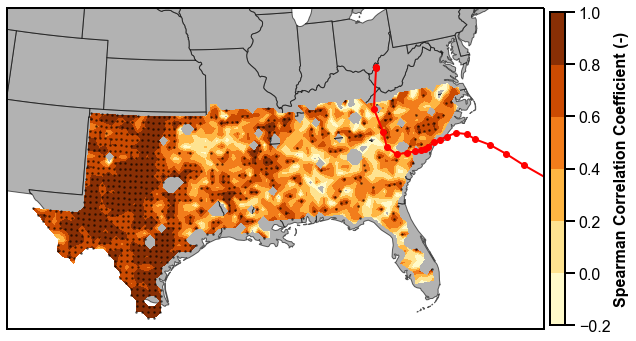

In [339]:
fig, ax = plt.subplots(figsize=(10,8), subplot_kw={'projection':proj})
ax.add_feature(cartopy.feature.STATES, alpha=0.6, facecolor='grey', zorder=0)
# Plot the initial frame. 
cax = ax.contourf(ds.lon.values, ds.lat.values, cc, cmap='YlOrBr',
                  transform=cartopy.crs.PlateCarree(),
                    levels= np.arange(-0.2,1.2,0.2))
xx,yy= np.meshgrid(ds.lon.values, ds.lat.values)
sig_x= xx[p<0.05]
sig_y= yy[p<0.05]
ax.scatter(sig_x, sig_y, s=10, c='k', marker='.', alpha=0.5, transform=cartopy.crs.PlateCarree())
tracks= np.array(dict_hurricanes[EVENT]['points'])
ax.plot(tracks[:,0], tracks[:,1], 'r',marker='o', transform=cartopy.crs.PlateCarree())

cb= fig.colorbar(mappable=cax, pad=0.01, fraction=0.028)
cb.set_label('Spearman Correlation Coefficient (-)')
ax.set_extent([-107, -74, 24, 41]);

In [397]:
dur_landfall= pd.date_range('2018-09-11', '2018-09-17', freq='D')

20180917


/home/ZhiLi/.conda/envs/xesmf_env/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


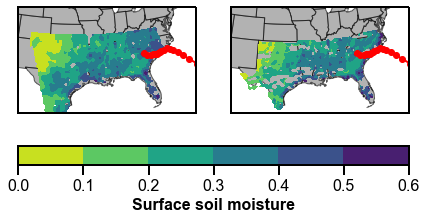

In [425]:
i=6

time= dur_landfall[i].strftime('%Y%m%d')
print(time)

iloc= pd.to_datetime(dict_hurricanes[EVENT]['datetime']).get_loc(dur_landfall[i],method='nearest')
tracks= np.array(dict_hurricanes[EVENT]['points'])
fig, axes= plt.subplots(1,2,figsize=(7, 4), subplot_kw={'projection': proj}, gridspec_kw={'hspace':0.01})
ax1= axes[0]
_sm= ds.sm_smap.sel(time_smap=time).mean(dim='time_smap').values
map=ax1.contourf(ds.lon.values, ds.lat.values, _sm.squeeze(),  cmap='viridis_r',
           transform=cartopy.crs.PlateCarree(),
                levels=np.arange(0,0.7,0.1))
ax1.add_feature(cartopy.feature.STATES, alpha=0.6, facecolor='grey', zorder=0)
ax1.plot(tracks[:iloc,0], tracks[:iloc,1], 'r',marker='o', transform=cartopy.crs.PlateCarree())
ax1.set_extent([-107, -74, 24, 41]);

ax2= axes[1]
_sm= ds.sm_cygnss.sel(time_cygnss=time).mean(dim='time_cygnss').values
map=ax2.contourf(ds.lon.values, ds.lat.values, _sm.squeeze(),  cmap='viridis_r',
           transform=cartopy.crs.PlateCarree(),
                levels=np.arange(0,0.7,0.1))
ax2.add_feature(cartopy.feature.STATES, alpha=0.6, facecolor='grey', zorder=0)
ax2.plot(tracks[:iloc,0], tracks[:iloc,1], 'r',marker='o', transform=cartopy.crs.PlateCarree())
ax2.set_extent([-107, -74, 24, 41]);
cb= fig.colorbar(ax=axes, orientation='horizontal', mappable=map)
cb.set_label('Surface soil moisture')
# for i in range(len(time)):
    

20180917


/home/ZhiLi/.conda/envs/xesmf_env/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


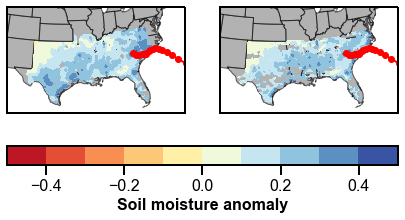

In [414]:
i=6

time= dur_landfall[i].strftime('%Y%m%d')
print(time)

iloc= pd.to_datetime(dict_hurricanes[EVENT]['datetime']).get_loc(dur_landfall[i],method='nearest')
tracks= np.array(dict_hurricanes[EVENT]['points'])
fig, axes= plt.subplots(1,2,figsize=(7, 4), subplot_kw={'projection': proj}, gridspec_kw={'hspace':0.01})
ax1= axes[0]
_sm= ds.sm_smap.sel(time_smap=time).mean(dim='time_smap').values - sm_aug_regrid/100.
map=ax1.contourf(ds.lon.values, ds.lat.values, _sm.squeeze(), cmap='RdYlBu',
           transform=cartopy.crs.PlateCarree(),
                levels=np.arange(-0.5,0.6,0.1))
ax1.add_feature(cartopy.feature.STATES, alpha=0.6, facecolor='grey', zorder=0)
ax1.plot(tracks[:iloc,0], tracks[:iloc,1], 'r',marker='o', transform=cartopy.crs.PlateCarree())
ax1.set_extent([-107, -74, 24, 41]);

ax2= axes[1]
_sm= ds.sm_cygnss.sel(time_cygnss=time).mean(dim='time_cygnss').values - sm_aug_regrid/100.
map=ax2.contourf(ds.lon.values, ds.lat.values, _sm.squeeze(), cmap='RdYlBu',
           transform=cartopy.crs.PlateCarree(),
                levels=np.arange(-0.5,0.6,0.1))
ax2.add_feature(cartopy.feature.STATES, alpha=0.6, facecolor='grey', zorder=0)
ax2.plot(tracks[:iloc,0], tracks[:iloc,1], 'r',marker='o', transform=cartopy.crs.PlateCarree())
ax2.set_extent([-107, -74, 24, 41]);
cb= fig.colorbar(ax=axes, orientation='horizontal', mappable=map)
cb.set_label('Soil moisture anomaly')
# for i in range(len(time)):
    

In [215]:
from matplotlib.ticker import FormatStrFormatter

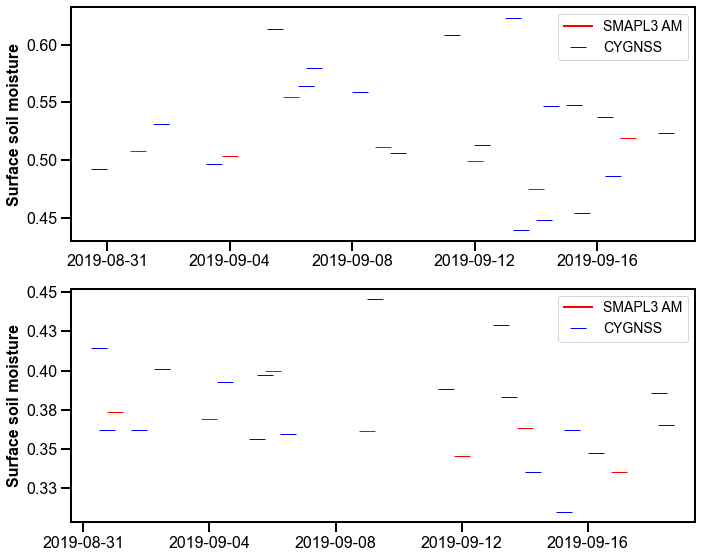

In [217]:
fig=plt.figure(figsize=(10,8))
ax= fig.add_subplot(211)
ax.plot(ds.time_smap.values, ds.sm_smap.values[:,10,68], color='r', marker='_', markersize=16, label='SMAPL3 AM')
ax.plot(ds.time_cygnss.values, ds.sm_cygnss.values[:,10,68],
        color='b', marker='_', linestyle='None', markersize=16, label='CYGNSS')
ax.set_xticks(ds.time_smap.values[::4])
ax.legend()
ax.set_ylabel('Surface soil moisture');
ax=fig.add_subplot(212)
ax.plot(ds.time_smap.values, ds.sm_smap.values[:,13,68], color='r', marker='_', markersize=16, label='SMAPL3 AM')
ax.plot(ds.time_cygnss.values, ds.sm_cygnss.values[:,13,68],
        color='b', marker='_', linestyle='None', markersize=16, label='CYGNSS')
ax.set_xticks(ds.time_smap.values[::4])
ax.yaxis.set_major_formatter(FormatStrFormatter('%0.2f'))
ax.legend()
ax.set_ylabel('Surface soil moisture');
# ax.set_xticklabels(ds.mean(dim=['lon','lat']).time_smap.values, rotation=15)